In [1]:
# for loading/processing the images  
from tensorflow.keras.preprocessing.image import load_img 
from tensorflow.keras.preprocessing.image import img_to_array 
from tensorflow.keras.applications.vgg16 import preprocess_input 

# models 
from tensorflow.keras.applications.vgg16 import VGG16 
from tensorflow.keras.models import Model

# clustering and dimension reduction
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

# for everything else
import os
import numpy as np
import matplotlib.pyplot as plt
from random import randint
import pandas as pd
import pickle

In [2]:
import cv2
import sys
import scipy as sp
from scipy.spatial import distance
import numpy as np
np.set_printoptions(threshold=np.inf) # To print the entire matrix
from os import listdir
from os.path import isfile, join
from matplotlib import pyplot as plt
from scipy.cluster.hierarchy import dendrogram, linkage
from scipy.cluster.hierarchy import fcluster
import timeit

In [3]:
path = r"/home/zhu690/Downloads/dog/"
# change the working directory to the path where the images are located
os.chdir(path)


# this list holds all the image filename
flowers = []

# creates a ScandirIterator aliased as files
with os.scandir(path) as files:
  # loops through each file in the directory
    for file in files:
        if file.name.endswith('.jpg'):
          # adds only the image files to the flowers list
            flowers.append(file.name)

In [3]:
#5dogs set label encode
# print(len(flowers))
# labs={}
# for i in flowers:
#     typ=i.split('_')[0]
#     if typ=='n02115913':
#         labs[i]=0
#     if typ=='n02113978':
#         labs[i]=1
#     if typ=='n02115641':
#         labs[i]=2
#     if typ=='n02115913':
#         labs[i]=3
#     if typ=='n02113799':
#         labs[i]=4
# len(labs)

789


620

In [4]:
# #show img
# img = load_img(flowers[0], target_size=(224,224))
# # convert from 'PIL.Image.Image' to numpy array
# img = np.array(img)
# reshaped_img = img.reshape(1,224,224,3)
# x = preprocess_input(reshaped_img)

(224, 224, 3)
(1, 224, 224, 3)


In [4]:
import time

# measure wall time
t0 = time.time()


# load the model first and pass as an argument
model = VGG16()
model = Model(inputs = model.inputs, outputs = model.layers[-2].output)

def extract_features(file, model):
    # load the image as a 224x224 array
    img = load_img(file, target_size=(224,224))
    # convert from 'PIL.Image.Image' to numpy array
    img = np.array(img) 
    # reshape the data for the model reshape(num_of_samples, dim 1, dim 2, channels)
    reshaped_img = img.reshape(1,224,224,3) 
    # prepare image for model
    imgx = preprocess_input(reshaped_img)
    # get the feature vector
    features = model.predict(imgx, use_multiprocessing=True)
    return features
data = {}
p = path
# lop through each image in the dataset
for flower in flowers:
    # try to extract the features and update the dictionary
    try:
        feat = extract_features(flower,model)
        data[flower] = feat
    # if something fails, save the extracted features as a pickle file (optional)
    except:
        with open(p,'wb') as file:
            pickle.dump(data,file)
          
# get a list of the filenames
filenames = np.array(list(data.keys()))

# get a list of just the features
feat = np.array(list(data.values()))
feat.shape

# reshape so that there are 210 samples of 4096 vectors
feat = feat.reshape(-1,4096)
feat.shape
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
data_rescaled = scaler.fit_transform(feat)
#95% of variance
pca = PCA(n_components = 0.95)
pca.fit(data_rescaled)
reduced = pca.transform(data_rescaled)
print (time.time() - t0)

488.8522193431854


In [7]:
feat

array([[1.85173893e+00, 1.55843544e+00, 5.52511311e+00, 0.00000000e+00,
        3.43616390e+00, 0.00000000e+00, 2.73039699e-01, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        4.53330308e-01, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 4.72019815e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 1.34746575e+00, 0.00000000e+00, 1.04368305e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 1.08266973e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 2.87781620e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 1.32023662e-01, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 1.82828546e+00, 0.00000000e+00, 1.400110

In [28]:
data = {}
p = path
# lop through each image in the dataset
for flower in flowers:
    # try to extract the features and update the dictionary
    try:
        feat = extract_features(flower,model)
        data[flower] = feat
    # if something fails, save the extracted features as a pickle file (optional)
    except:
        with open(p,'wb') as file:
            pickle.dump(data,file)
          
# get a list of the filenames
filenames = np.array(list(data.keys()))

# get a list of just the features
feat = np.array(list(data.values()))
feat.shape

# reshape so that there are 210 samples of 4096 vectors
feat = feat.reshape(-1,4096)
feat.shape

(100, 4096)

In [29]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
data_rescaled = scaler.fit_transform(feat)

In [30]:
#95% of variance
pca = PCA(n_components = 0.95)
pca.fit(data_rescaled)
reduced = pca.transform(data_rescaled)

In [6]:
print('reduced features matrix: '+ str(reduced.shape))

reduced features matrix: (100, 83)


In [6]:
reduced.shape

(2335, 1077)

In [39]:
#95% of variance
pca = PCA(n_components = 100)
pca.fit(feat)
reduced = pca.transform(feat)

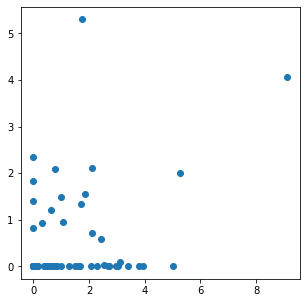

In [41]:
plt.figure(figsize=(5,5))
plt.scatter(feat[:,0],feat[:,1],cmap='prism')
plt.show()

The Clusters are:
[ 8 16 20 15 19 17 19 18  9 17 20  6  9 19 11  1 11 18 15  6  8 18  1 15
 20  6 16 10 18  2 19  1 18 15  9 10  9 10  6 14 18 18  6 15  9  9  5  9
 18  3 19 12 17  9  1 20 14  6 11 18 15 19 16 17  5 13  2 18  6 20  4 18
 18 15  6 17 12  7 18 14  6 18  8 13 17 19 20  8 13  6  2  1 17 12  1 16
 19 14 18 15]


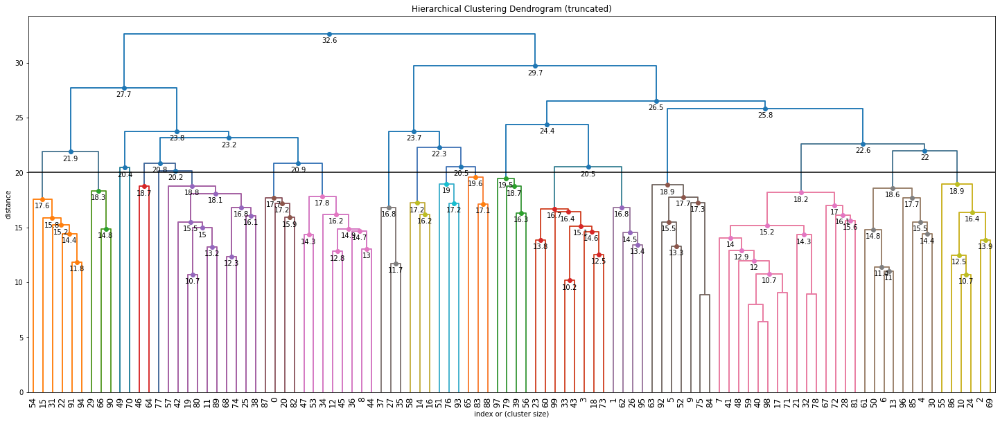

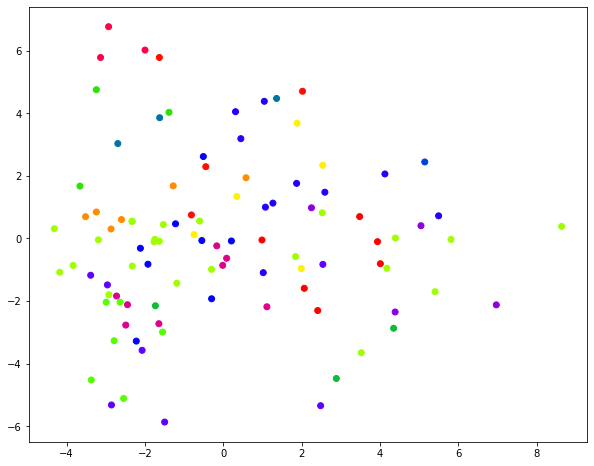

In [82]:
#hierarchical clustering 
def fancy_dendrogram(*args, **kwargs):
    max_d = kwargs.pop('max_d', None)
    if max_d and 'color_threshold' not in kwargs:
        kwargs['color_threshold'] = max_d
    annotate_above = kwargs.pop('annotate_above', 0)

    ddata = dendrogram(*args, **kwargs)

    if not kwargs.get('no_plot', False):
        plt.title('Hierarchical Clustering Dendrogram (truncated)')
        plt.xlabel('index or (cluster size)')
        plt.ylabel('distance')
        for i, d, c in zip(ddata['icoord'], ddata['dcoord'], ddata['color_list']):
            x = 0.5 * sum(i[1:3])
            y = d[1]
            if y > annotate_above:
                plt.plot(x, y, 'o', c=c)
                plt.annotate("%.3g" % y, (x, y), xytext=(0, -5),
                             textcoords='offset points',
                             va='top', ha='center')
        if max_d:
            plt.axhline(y=max_d, c='k')
    return ddata

def hClustering(dmatrix):

    # Link the clusters using
    Z = linkage(dmatrix, 'ward')

    # Plot the dendrogram with default values with x-axis having the index
    # and y-axis having the distance
    plt.figure(figsize=(25,10))
    plt.title('Hierarchical')
    plt.xlabel('index')
    plt.ylabel('distance')
    dendrogram(Z, leaf_rotation=90.,leaf_font_size=8.,)
    plt.savefig('dendrogram.png')

    # Setting the cutOff value, this is the distance value on the y-axis
    cutOff =20

    # Plot the truncated Dendrogram indicating the number of clusters formed below the specified value (max_d)
    # with x-axis having the index and y-axis having the distance
    fancy_dendrogram(Z,
    truncate_mode='lastp',  # show only the last p merged clusters
    p=100, # show only the last p merged clusters
    leaf_rotation=90.,
    leaf_font_size=12.,
    show_contracted=True,
    annotate_above=10,
    max_d=cutOff,)
    plt.savefig('dendrogram_kcluster.png')

    # Retrieving the clusters, passing the horizontal cut off value
    clusters = fcluster(Z, cutOff, criterion='distance')
    print("The Clusters are:")
    print(clusters)

    # After getting the clusters, plot them using scatter plots
    plt.figure(figsize=(10, 8))
    plt.scatter(dmatrix[:,0], dmatrix[:,1], c=clusters, cmap='prism')  # plot points with cluster dependent colors
    plt.savefig('hierarchical_scatterPlot.png')
    return clusters
hircluster=hClustering(reduced)

In [17]:
groups = {}
for file, cluster in zip(filenames,hircluster):
    if cluster not in groups.keys():
        groups[cluster] = []
        groups[cluster].append(file)
    else:
        groups[cluster].append(file)
with open('hir_cluster_result.txt', 'w') as f:
    print(groups, file=f)

In [23]:
def view_cluster(cluster):
    plt.figure(figsize = (45,45));
    # gets the list of filenames for a cluster
    files = groups[cluster]
    # only allow up to 30 images to be shown at a time
    if len(files) > 30:
        print(f"Clipping cluster size from {len(files)} to 30")
        files = files[:50]
    # plot each image in the cluster
    for index, file in enumerate(files):
        plt.subplot(10,10,index+1);
        img = load_img(file)
        img = np.array(img)
        plt.imshow(img)
        plt.axis('off')

In [10]:
#manually select number of features
# pca = PCA(n_components=100, random_state=22)
# pca.fit(feat)
# x = pca.transform(feat)

In [ ]:
from scipy.spatial.distance import cdist
from sklearn.metrics import silhouette_score
distortions = []
inertias = []
mapping1 = {}
mapping2 = {}
silhouette=[]
K = range(2,2335)
x=reduced
for k in K:
    # Building and fitting the model
    kmeanModel = KMeans(n_clusters=k).fit(x)
    kmeanModel.fit(x)
    sse=sum(np.min(cdist(x, kmeanModel.cluster_centers_,
                                        'euclidean'), axis=1)) / x.shape[0]
    distortions.append(sse)
    inertias.append(kmeanModel.inertia_)
 
    mapping1[k] = sum(np.min(cdist(x, kmeanModel.cluster_centers_,
                                   'euclidean'), axis=1)) / x.shape[0]
    mapping2[k] = kmeanModel.inertia_
    
    silhouette.append(silhouette_score(x, kmeanModel.labels_))
    if k!=2 and k%100==0:
        print('distrotions')
        print(distortions)
        print('silhouette')
        print(silhouette)

In [32]:
sil_k=K[(s.index(max(s)))]

In [33]:
sil_k

7

In [61]:
from kneed import KneeLocator
kn = KneeLocator(range(2,2+219), distor, curve='convex', direction='decreasing')
knee_k=(kn.knee)
knee_k

30

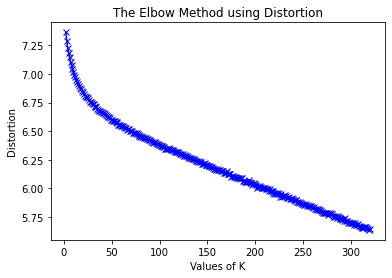

In [5]:
plt.plot(range(2,2+319), distor, 'bx-')
plt.xlabel('Values of K')
plt.ylabel('Distortion')
plt.title('The Elbow Method using Distortion')
plt.show()

In [15]:
s=[0.026219504, 0.02411633, 0.021230321, 0.024402706, 0.02381602, 0.026571129, 0.025649093, 0.02329015, 0.019147506, 0.016773464, 0.019918242, 0.01853506, 0.015798409, 0.018704623, 0.019686554, 0.019174224, 0.014338673, 0.019340146, 0.020225368, 0.021871373, 0.022246923, 0.01811044, 0.018340074, 0.017117854, 0.014734813, 0.015015413, 0.014704744, 0.0132559845, 0.016743096, 0.019569658, 0.01681684, 0.01456324, 0.017830756, 0.015151083, 0.013072068, 0.013535894, 0.0112105645, 0.0011808048, 0.01254306, 0.012591954, 0.008756217, 0.0048198886, 0.01074504, 0.015550238, 0.0067588445, 0.008351652, 0.015743483, 0.012425626, 0.010638633, 0.011119295, 0.0077237687, 0.0145162875, 0.0060324715, 0.010537225, 0.010060922, 0.013219517, 0.009566314, 0.008987197, 0.01208766, 0.01629919, 0.011103132, 0.007911065, 0.008800004, 0.01302241, 0.007141248, 0.0016569106, 0.0056125233, 0.008815913, 0.013505255, 0.00014577647, 0.011649734, 0.0052469936, -0.0031555388, 0.013461229, 0.006026479, 0.0082806945, 0.0059030177, 0.005920311, 0.010551827, 0.008041802, 0.01252744, 0.0059355036, 0.0062524313, 0.000749842, 0.010498546, -0.011064465, 0.0066237184, 0.0024188377, 0.009002169, 0.0036726187, 0.006574958, -0.0122372005, 0.00885343, 0.0069295764, 0.003211398, 0.012286823, 0.007480484, 0.009723238, -0.0006390206, 0.0031911267, 0.0026787298, 0.009452032, 0.004889453, -0.00012754067, 0.0044824774, 0.008524148, 0.007825337, -0.0013082274, 0.0052657453, 0.0031437902, 0.0009095402, 0.004078029, 0.009196196, 0.00779515, 0.004265192, 0.0054550776, 0.0026996683, 0.005935817, 0.011614334, 0.004954599, 0.0073407223, -0.004209629, 0.00090651185, 0.003976058, 0.003775177, 0.0011356798, 0.004504675, -0.008723942, 0.0075096637, 0.008779628, 0.0049682306, -0.002478615, 0.006584201, 0.0055964813, 0.006673468, 0.006188126, -0.006439964, -0.00464018, -0.010523831, 0.006188741, 0.0048590754, 0.0032599762, 0.010160629, 0.008606903, 0.0027951433, 0.009371704, 0.0019985344, -0.0061099795, 0.0017214763, 0.0021673583, 0.00514476, 0.0006039747, -0.005270149, 0.0057809204, -0.0015062484, 0.0040385006, -0.0044103055, 0.009013261, 0.002181808]

distor=[7.362974017323504, 7.288525086723162, 7.228444786725707, 7.182849197462678, 7.143435229551432, 7.103393682725144, 7.075426343126087, 7.043365484564102, 7.020042151122842, 6.9925519484788605, 6.971569865193469, 6.948581142290431, 6.931392623122938, 6.913793911567274, 6.893104154192423, 6.8799012019672166, 6.864618875074562, 6.850535080048562, 6.837638276275824, 6.82692437396083, 6.810888281093333, 6.801395440145523, 6.798686166175565, 6.786748006573586, 6.775790829204957, 6.758701486838367, 6.757923110779888, 6.749654570796467, 6.733974744328293, 6.734984502363775, 6.72267719114462, 6.710551888561693, 6.707169350074653, 6.69305344524514, 6.687599486190874, 6.680107614266432, 6.6749039375442765, 6.665444077639852, 6.666968002853634, 6.654237479758078, 6.655733669201855, 6.645948136682651, 6.63906472167941, 6.629675403150176, 6.626328464066134, 6.622644728352836, 6.614173294609399, 6.601363064022943, 6.599830760792336, 6.59264212750953, 6.585818096594213, 6.586120409348738, 6.580093873837693, 6.578199061306439, 6.571928203704955, 6.556700830091388, 6.557087423131533, 6.555354731259338, 6.547580138598514, 6.548016486932422, 6.547257954562185, 6.532046173608051, 6.527511801496116, 6.523727966457125, 6.513094466891154, 6.519133141841513, 6.515123474616961, 6.505023158653395, 6.504046346029906, 6.497711874561832, 6.486552149482395, 6.486817662143123, 6.488205910736664, 6.477411224544755, 6.482351191813171, 6.474926938154579, 6.464508484036403, 6.458216102465138, 6.448390640842004, 6.456148036168581, 6.445688536765046, 6.447737853020054, 6.438670962857981, 6.441815522141941, 6.437090428698, 6.435917871582753, 6.429032269447804, 6.420157328467216, 6.419977491286799, 6.412136704976395, 6.4074300988927275, 6.400553848288202, 6.405324233849834, 6.403782390262171, 6.39823423821473, 6.3867632017797895, 6.38605984130455, 6.3812046271206375, 6.381232791800007, 6.369795588061698, 6.372641397543518, 6.3713784678589525, 6.358829409467573, 6.365425915398464, 6.347715015625584, 6.345288596581576, 6.342565892907724, 6.341106366229524, 6.350615186850302, 6.3443730283422894, 6.3347967007765265, 6.335828298772342, 6.335476506583581, 6.329510163023854, 6.322092803454683, 6.320472033934411, 6.31809772445398, 6.314649664640009, 6.307136541993387, 6.302016583592462, 6.2982770182037875, 6.29369436084329, 6.299853813582582, 6.286920738351969, 6.2814622826667845, 6.292753370892536, 6.279310420867524, 6.281647814994827, 6.273457299968917, 6.264732557829292, 6.263870975873325, 6.264848462191535, 6.25777176499353, 6.256614600351686, 6.25355277765666, 6.249376396398297, 6.238151314329023, 6.240474132057398, 6.231534623093754]

In [3]:
distor=[7.362974017323504, 7.288525086723162, 7.228444786725707, 7.182849197462678, 7.143435229551432, 7.103393682725144, 7.075426343126087, 7.043365484564102, 7.020042151122842, 6.9925519484788605, 6.971569865193469, 6.948581142290431, 6.931392623122938, 6.913793911567274, 6.893104154192423, 6.8799012019672166, 6.864618875074562, 6.850535080048562, 6.837638276275824, 6.82692437396083, 6.810888281093333, 6.801395440145523, 6.798686166175565, 6.786748006573586, 6.775790829204957, 6.758701486838367, 6.757923110779888, 6.749654570796467, 6.733974744328293, 6.734984502363775, 6.72267719114462, 6.710551888561693, 6.707169350074653, 6.69305344524514, 6.687599486190874, 6.680107614266432, 6.6749039375442765, 6.665444077639852, 6.666968002853634, 6.654237479758078, 6.655733669201855, 6.645948136682651, 6.63906472167941, 6.629675403150176, 6.626328464066134, 6.622644728352836, 6.614173294609399, 6.601363064022943, 6.599830760792336, 6.59264212750953, 6.585818096594213, 6.586120409348738, 6.580093873837693, 6.578199061306439, 6.571928203704955, 6.556700830091388, 6.557087423131533, 6.555354731259338, 6.547580138598514, 6.548016486932422, 6.547257954562185, 6.532046173608051, 6.527511801496116, 6.523727966457125, 6.513094466891154, 6.519133141841513, 6.515123474616961, 6.505023158653395, 6.504046346029906, 6.497711874561832, 6.486552149482395, 6.486817662143123, 6.488205910736664, 6.477411224544755, 6.482351191813171, 6.474926938154579, 6.464508484036403, 6.458216102465138, 6.448390640842004, 6.456148036168581, 6.445688536765046, 6.447737853020054, 6.438670962857981, 6.441815522141941, 6.437090428698, 6.435917871582753, 6.429032269447804, 6.420157328467216, 6.419977491286799, 6.412136704976395, 6.4074300988927275, 6.400553848288202, 6.405324233849834, 6.403782390262171, 6.39823423821473, 6.3867632017797895, 6.38605984130455, 6.3812046271206375, 6.381232791800007, 6.369795588061698, 6.372641397543518, 6.3713784678589525, 6.358829409467573, 6.365425915398464, 6.347715015625584, 6.345288596581576, 6.342565892907724, 6.341106366229524, 6.350615186850302, 6.3443730283422894, 6.3347967007765265, 6.335828298772342, 6.335476506583581, 6.329510163023854, 6.322092803454683, 6.320472033934411, 6.31809772445398, 6.314649664640009, 6.307136541993387, 6.302016583592462, 6.2982770182037875, 6.29369436084329, 6.299853813582582, 6.286920738351969, 6.2814622826667845, 6.292753370892536, 6.279310420867524, 6.281647814994827, 6.273457299968917, 6.264732557829292, 6.263870975873325, 6.264848462191535, 6.25777176499353, 6.256614600351686, 6.25355277765666, 6.249376396398297, 6.238151314329023, 6.240474132057398, 6.231534623093754, 6.237957231962227, 6.231334825528134, 6.227608261040226, 6.209846647633782, 6.2127295518906545, 6.213646873719311, 6.226386449336746, 6.208792351158635, 6.206426812584431, 6.204004037431525, 6.1949760120380635, 6.1972270205486595, 6.19401280487139, 6.188511905729244, 6.186506857058947, 6.181504481408857, 6.172426566396324, 6.173944847294828, 6.165269108100762, 6.171703833904072, 6.158248570359382, 6.157938938764213, 6.157842340796717, 6.149418718564916, 6.1534669712268, 6.1520683125580335, 6.1363553316746415, 6.135871020524487, 6.138195877603866, 6.14803473296385, 6.1298669983171274, 6.123426136051704, 6.129714447490847, 6.124403861284411, 6.103866020456533, 6.106116936009073, 6.11117204274664, 6.10150080095212, 6.1005043534868575, 6.101299920768299, 6.090721878032403, 6.088285140781981, 6.0905849228544415, 6.0847920423475, 6.089777067816008, 6.087459450198642, 6.068035511195307, 6.065394721376991, 6.05394053683561, 6.058074410561891, 6.059059191382461, 6.059845206397696, 6.073941531355719, 6.057993978075015, 6.048383069969738, 6.046713801066862, 6.028780400169861, 6.038009713051805, 6.049861478358027, 6.035483504354434, 6.032941891151824, 6.00631624067331, 6.021624380087665, 6.010852247197312, 6.024351939068892, 6.009538012794376, 6.008150396021295, 5.999772395614629, 6.002496062765042, 6.003733993190782, 5.996836284911185, 5.99184287599217, 5.993650129195975, 5.9775834717334195, 5.992151780473492, 5.97603022390972, 5.976932430512973, 5.976788144360254, 5.9578073069297055, 5.952798553450296, 5.9612761002675825, 5.954879709413853, 5.958401961113768, 5.948642182679245, 5.964393630204471, 5.927309318313573, 5.95385506269869, 5.922732867859241, 5.9336909260762285, 5.936006396568339, 5.9394927678235785, 5.934348187337255, 5.920789324799171, 5.9179792378563905, 5.922117280765506, 5.910212053129873, 5.908746168740437, 5.913011515740851, 5.90441566757823, 5.898614046330695, 5.8880103163517585, 5.900915184177375, 5.902026977594117, 5.8817867982234935, 5.879312307449672, 5.869355607509974, 5.8831235687086485, 5.870541253269337, 5.868605694609447, 5.863781564418185, 5.858409150309961, 5.852557462490148, 5.862268741249772, 5.847581181143906, 5.857599054660067, 5.849958293184713, 5.843458764034578, 5.844100555476233, 5.836123118299599, 5.833172544747136, 5.842191938622353, 5.821199202393615, 5.823005361398767, 5.8083047456438335, 5.8232563517604765, 5.81821253176434, 5.810364445707021, 5.8100514576560816, 5.806996954049891, 5.796919637000425, 5.788716080040995, 5.788442450922281, 5.786828404027028, 5.784019073023751, 5.787172376273535, 5.7671721428906695, 5.785222483167693, 5.775377669752114, 5.781756443670456, 5.780245506449991, 5.7611961445663225, 5.754716511264567, 5.7545208210547445, 5.755929407449756, 5.743522031275442, 5.762385916197784, 5.751302681687494, 5.743447876800671, 5.737795315385851, 5.73416538963924, 5.721974713911592, 5.73765356426918, 5.717672819778517, 5.740615612253306, 5.716839550331971, 5.718021112220356, 5.702141603487216, 5.706837293882557, 5.6978097365041975, 5.7012029202921335, 5.699509663877047, 5.699540935175628, 5.681968803840143, 5.697525416777103, 5.684817325715943, 5.6855138535114165, 5.690844188940665, 5.675846374456746, 5.676815616543083, 5.659719878986583, 5.652519482914278, 5.667731926519899, 5.656554782282635, 5.6644057210529235, 5.65954117686794, 5.661739858345783, 5.652517581635921, 5.642755360844723, 5.638360290850438, 5.644525504947295]

s=[0.026219504, 0.02411633, 0.021230321, 0.024402706, 0.02381602, 0.026571129, 0.025649093, 0.02329015, 0.019147506, 0.016773464, 0.019918242, 0.01853506, 0.015798409, 0.018704623, 0.019686554, 0.019174224, 0.014338673, 0.019340146, 0.020225368, 0.021871373, 0.022246923, 0.01811044, 0.018340074, 0.017117854, 0.014734813, 0.015015413, 0.014704744, 0.0132559845, 0.016743096, 0.019569658, 0.01681684, 0.01456324, 0.017830756, 0.015151083, 0.013072068, 0.013535894, 0.0112105645, 0.0011808048, 0.01254306, 0.012591954, 0.008756217, 0.0048198886, 0.01074504, 0.015550238, 0.0067588445, 0.008351652, 0.015743483, 0.012425626, 0.010638633, 0.011119295, 0.0077237687, 0.0145162875, 0.0060324715, 0.010537225, 0.010060922, 0.013219517, 0.009566314, 0.008987197, 0.01208766, 0.01629919, 0.011103132, 0.007911065, 0.008800004, 0.01302241, 0.007141248, 0.0016569106, 0.0056125233, 0.008815913, 0.013505255, 0.00014577647, 0.011649734, 0.0052469936, -0.0031555388, 0.013461229, 0.006026479, 0.0082806945, 0.0059030177, 0.005920311, 0.010551827, 0.008041802, 0.01252744, 0.0059355036, 0.0062524313, 0.000749842, 0.010498546, -0.011064465, 0.0066237184, 0.0024188377, 0.009002169, 0.0036726187, 0.006574958, -0.0122372005, 0.00885343, 0.0069295764, 0.003211398, 0.012286823, 0.007480484, 0.009723238, -0.0006390206, 0.0031911267, 0.0026787298, 0.009452032, 0.004889453, -0.00012754067, 0.0044824774, 0.008524148, 0.007825337, -0.0013082274, 0.0052657453, 0.0031437902, 0.0009095402, 0.004078029, 0.009196196, 0.00779515, 0.004265192, 0.0054550776, 0.0026996683, 0.005935817, 0.011614334, 0.004954599, 0.0073407223, -0.004209629, 0.00090651185, 0.003976058, 0.003775177, 0.0011356798, 0.004504675, -0.008723942, 0.0075096637, 0.008779628, 0.0049682306, -0.002478615, 0.006584201, 0.0055964813, 0.006673468, 0.006188126, -0.006439964, -0.00464018, -0.010523831, 0.006188741, 0.0048590754, 0.0032599762, 0.010160629, 0.008606903, 0.0027951433, 0.009371704, 0.0019985344, -0.0061099795, 0.0017214763, 0.0021673583, 0.00514476, 0.0006039747, -0.005270149, 0.0057809204, -0.0015062484, 0.0040385006, -0.0044103055, 0.009013261, 0.002181808, 0.0075710174, 0.0023218635, 0.0019409382, 0.0066870283, 6.724374e-05, 0.0045369933, -0.00030864857, 0.000114308794, -0.0037146844, 0.0022580777, -0.0066236523, 0.0056992234, 0.0030091403, -0.001623489, 0.0071659097, -0.00046298336, -0.0019808405, 0.001949883, 0.0038505378, 0.0049092546, 0.0030441093, 0.002502519, 0.0027715028, -0.0011350595, 0.0026953018, 0.0017260674, 2.4918008e-05, 0.0041312454, 0.008683083, 0.003723143, 0.0005675797, 0.00016561091, -0.016112493, -0.003864259, 0.0025417234, 0.0027785043, 0.0001641756, -0.0025434503, -0.0027694989, 0.005538378, -0.0040549124, 0.0031207246, -0.00014636746, -0.0002674229, -0.0028339298, -0.003462479, 8.082497e-05, 0.0010579303, -0.007729452, 0.0018870217, 0.0031218, 0.005662781, -0.00078204344, -0.0034951188, 0.0015583147, 1.1422956e-05, 0.003641436, -0.0017019439, 0.0013208787, 0.006065486, -0.002414525, -0.006422047, -0.000976315, -0.012634531, -0.0038263733, -0.0011799247, -0.0071534826, -0.005905306, 0.0004977113, -0.0007900574, -0.0031836394, -0.000116990974, 0.004900584, -0.00083455275, -0.0043952772, -0.0003166661, -0.0032375653, -0.0019780695, -0.005793517, 0.0040077535, 0.0017829821, 0.0006230851, -0.0026796446, -0.002871595, 0.0020039862, 0.0017995471, 0.0033912058, 0.0014337979, 0.000623077, -0.0053450437, 0.0006662439, 0.0032295904, -0.00469684, -0.0062835584, -0.0011607847, -0.0012286939, -0.009014552, 0.0033624095, 0.004049336, 0.0024435718, -0.003145855, 0.0022407894, 0.0036925615, -0.003283113, -0.016411072, -0.008684042, -0.0068174163, 0.004568443, -0.0014983144, 0.0010075087, -0.0022916065, 0.003706199, -0.0079751825, 8.089843e-05, 9.8310345e-05, 0.0013573797, 0.00013429848, -0.0052181897, -0.0033436783, 0.00017924707, -0.0016276733, 0.00021785607, -0.0022732546, 0.0020345761, -0.0067984075, -0.0023833509, -0.002035241, -0.0021699322, 0.00028513736, 0.001170135, -0.004904844, -0.004622914, 0.0014538405, -0.0057787304, -0.00034459803, -0.0063652145, -0.0013782858, 0.0023267504, -0.0054223128, 0.0027647503, 0.0007524306, 0.0034866594, 0.00260824, 0.0015734651, -0.008725093, -0.002431895, 0.0019739342, -0.0024091685, -0.004052433, -0.0017007669, 0.00051617477, 0.0014023742, -0.00017569716, 0.002099491, -0.0028746857, -0.0029863124, -0.00027285705, 0.0008652719, -2.646089e-06, -0.000156706]


In [4]:
print(len(distor))

319


In [5]:
kmeans = KMeans(n_clusters=30,n_jobs=-1, random_state=22)
kmeans.fit(reduced)

/home/zhu690/anaconda3/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:973: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn("'n_jobs' was deprecated in version 0.23 and will be"


KMeans(n_clusters=30, n_jobs=-1, random_state=22)

In [6]:
kmeans

KMeans(n_clusters=30, n_jobs=-1, random_state=22)

In [67]:
reduced[:, 0]
reduced[:, 1]

array([-2.348981  ,  1.3422961 , -5.1106596 ,  2.6176484 , -0.63254225,
       -5.8645225 , -2.182754  , -1.7981559 ,  0.8190933 , -3.5732284 ,
       -2.9896798 ,  1.7601618 , -3.651462  , -0.8585992 ,  1.6738136 ,
       -1.5926924 ,  4.752588  , -0.8620534 , -0.31248465,  2.0609484 ,
       -2.1215987 , -1.0791702 , -0.80685437, -0.06645375, -2.0362709 ,
        3.188435  ,  2.338298  ,  6.7654443 , -0.8812048 , -2.1502986 ,
       -1.8384726 , -2.3027437 , -0.04228735, -0.07998625,  0.01508752,
        6.0179687 , -0.03146419,  5.781025  , -1.0927873 ,  0.302809  ,
        0.4435612 , -1.4301627 ,  4.0492635 , -0.8227894 , -0.9527137 ,
       -0.5789919 ,  0.6039437 ,  0.38426456,  0.54532707,  0.751095  ,
       -2.76711   ,  2.2923143 , -5.3425555 , -1.7004489 , -0.1026877 ,
       -4.520985  ,  1.6803155 ,  4.382059  ,  4.0302153 , -0.08897202,
       -1.9266893 , -2.1165087 , -0.96003395, -0.82734597,  1.9393941 ,
        4.47211   , -4.4736223 , -0.02837385,  1.1291268 , -3.26

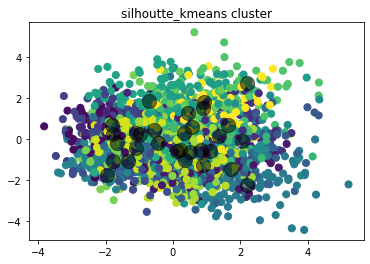

In [12]:
y_kmeans = kmeans.predict(reduced)
plt.scatter(reduced[:, 0],reduced[:, 1], c=y_kmeans, s=50, cmap='viridis')

centers = kmeans.cluster_centers_
plt.title('silhoutte_kmeans cluster')
plt.scatter(centers[:, 0], centers[:, 1], c='black', s=200, alpha=0.5);


In [44]:
kmeans.labels_

array([ 5,  2,  4,  1,  5,  9,  5, 10,  6,  3,  4, 10,  9,  5,  5,  8,  5,
        0,  1,  6,  6,  0,  8,  1,  4,  5,  2,  7,  0, 10,  1,  8, 10,  1,
        6,  7,  6,  7,  5, 10, 10, 10, 10,  1,  6,  1, 10, 11, 10,  5,  5,
        5,  9, 11,  6,  5, 10,  5,  5,  5,  1,  5,  2,  5, 10, 10,  9, 10,
       10,  0,  6,  0, 10,  1, 10,  3,  5, 10,  5,  1,  1,  5,  6, 10,  3,
        5,  4, 10, 10,  6,  9,  8,  9,  8,  8,  2,  5, 10, 10,  1],
      dtype=int32)

In [7]:
#cluster dic key:index, val: filename
groups = {}
for file, cluster in zip(filenames,kmeans.labels_):
    if cluster not in groups.keys():
        groups[cluster] = []
        groups[cluster].append(file)
    else:
        groups[cluster].append(file)

In [40]:
#check numbet of items in each cluster
sizes={}
selection={}
for i in groups:
    sizes[i]=len(groups[i])
smallest=min(sizes.values())
for i in groups:
    fraction[i]=int(len(groups[i])/smallest)

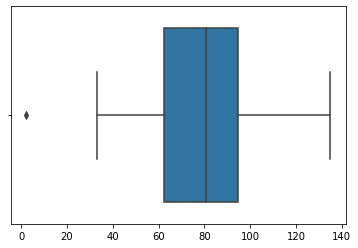

In [53]:
import seaborn as sns
sns.boxplot(x=sorted(sizes.values()))

In [52]:
sizes

{7: 99,
 29: 97,
 19: 57,
 15: 81,
 18: 89,
 24: 53,
 26: 135,
 13: 126,
 28: 33,
 21: 41,
 14: 71,
 20: 94,
 1: 82,
 16: 80,
 12: 86,
 10: 75,
 17: 115,
 27: 95,
 3: 68,
 6: 68,
 25: 95,
 8: 38,
 22: 88,
 4: 62,
 5: 112,
 2: 89,
 9: 64,
 23: 80,
 11: 60,
 0: 2}

In [32]:
pca = PCA(n_components = 0.95)
pca.fit(data_rescaled)
reduced = pca.transform(data_rescaled)
kmeans = KMeans(n_clusters=12,n_jobs=-1, random_state=22)
kmeans.fit(reduced)
#cluster dic key:index, val: filename
groups = {}
for file, cluster in zip(filenames,kmeans.labels_):
    if cluster not in groups.keys():
        groups[cluster] = []
        groups[cluster].append(file)
    else:
        groups[cluster].append(file)

/home/zhu690/anaconda3/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:973: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn("'n_jobs' was deprecated in version 0.23 and will be"


In [9]:
result={}

fraction={}
for i in groups:
    fraction[i]=len(groups[i])
smallest=min(fraction.values())
for i in groups:
    fraction[i]=int(len(groups[i])/smallest)

In [29]:
import math
#proportion to 10%
#calculate each point distance to centroid
def k_mean_distance(data, cantroid_matrix, i_centroid, cluster_labels):
    distances=[]
    # Calculate Euclidean distance for each data point assigned to centroid
    for file,x in zip(groups[i_centroid],data[cluster_labels == i_centroid]):
       # print(file)
        d=np.linalg.norm(x-cantroid_matrix)
        distances.append((file,d))
    # return the mean value
    return (distances)  

# y_kmeans = kmeans.fit_predict(reduced)
centroids = kmeans.cluster_centers_
result={} #dictionary key as cluster index, value as ([image list],original cluster size)
sizes={}
for i in groups:
    sizes[i]=len(groups[i])

#select number of images from each cluster

for i in groups:
    fraction[i]=math.ceil(len(groups[i])*0.1)

for i, cent_features in enumerate(centroids):
    select_num=fraction[i]
    c_distances = k_mean_distance(reduced, cent_features, i, y_kmeans)
    sort_res=sorted(c_distances, key=lambda tup: tup[1])[:select_num]
    sort_res1=[x[0] for x in sort_res]
    if i not in result.keys():
        result[i] = []
        result[i].append((sort_res1,sizes[i]))
    else:
        result[i].append((sort_res1,sizes[i]))

In [30]:
result

{0: [(['3574847368.jpg'], 2)],
 1: [(['3514019869.jpg',
    '2839807428.jpg',
    '825918657.jpg',
    '3695064885.jpg',
    '1351315701.jpg',
    '1859941832.jpg',
    '1110208841.jpg',
    '2892992529.jpg',
    '2102581664.jpg'],
   82)],
 2: [(['2404692474.jpg',
    '2584487952.jpg',
    '3159447439.jpg',
    '2654514044.jpg',
    '2493469969.jpg',
    '3228793611.jpg',
    '2271264741.jpg',
    '3600221224.jpg',
    '2505465055.jpg'],
   89)],
 3: [(['2410320522.jpg',
    '2844747252.jpg',
    '2559114800.jpg',
    '2833582518.jpg',
    '2630507245.jpg',
    '2813588204.jpg',
    '2430860418.jpg'],
   68)],
 4: [(['3656206975.jpg',
    '3382105769.jpg',
    '3613242966.jpg',
    '2369248869.jpg',
    '1731546544.jpg',
    '2089350172.jpg',
    '2867736861.jpg'],
   62)],
 5: [(['3532098999.jpg',
    '3028561714.jpg',
    '2718049631.jpg',
    '3599568766.jpg',
    '562928217.jpg',
    '2462153092.jpg',
    '3535284878.jpg',
    '717673249.jpg',
    '2860400846.jpg',
    '3466891862

In [54]:
#proportion to smallest cluster
#calculate each point distance to centroid
def k_mean_distance(data, cantroid_matrix, i_centroid, cluster_labels):
    distances=[]
    # Calculate Euclidean distance for each data point assigned to centroid
    for file,x in zip(groups[i_centroid],data[cluster_labels == i_centroid]):
       # print(file)
        d=np.linalg.norm(x-cantroid_matrix)
        distances.append((file,d))
    # return the mean value
    return (distances)  

y_kmeans = kmeans.fit_predict(reduced)
centroids = kmeans.cluster_centers_
result={} #dictionary key as cluster index, value as ([image list],original cluster size)

#select number of images from each cluster
fraction={}
for i in groups:
    fraction[i]=len(groups[i])
smallest=min(fraction.values())
for i in groups:
    fraction[i]=int(len(groups[i])/smallest)

for i, cent_features in enumerate(centroids):
    select_num=fraction[i]
    c_distances = k_mean_distance(reduced, cent_features, i, y_kmeans)
    sort_res=sorted(c_distances, key=lambda tup: tup[1])[:select_num]
    sort_res1=[x[0] for x in sort_res]
    if i not in result.keys():
        result[i] = []
        result[i].append((sort_res1,sizes[i]))
    else:
        result[i].append((sort_res1,sizes[i]))

/home/zhu690/anaconda3/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:973: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn("'n_jobs' was deprecated in version 0.23 and will be"


In [15]:
result

{0: [(['3574847368.jpg'], 2)],
 1: [(['3514019869.jpg',
    '2839807428.jpg',
    '825918657.jpg',
    '3695064885.jpg',
    '1351315701.jpg',
    '1859941832.jpg',
    '1110208841.jpg',
    '2892992529.jpg',
    '2102581664.jpg'],
   82)],
 2: [(['2404692474.jpg',
    '2584487952.jpg',
    '3159447439.jpg',
    '2654514044.jpg',
    '2493469969.jpg',
    '3228793611.jpg',
    '2271264741.jpg',
    '3600221224.jpg',
    '2505465055.jpg'],
   89)],
 3: [(['2410320522.jpg',
    '2844747252.jpg',
    '2559114800.jpg',
    '2833582518.jpg',
    '2630507245.jpg',
    '2813588204.jpg',
    '2430860418.jpg'],
   68)],
 4: [(['3656206975.jpg',
    '3382105769.jpg',
    '3613242966.jpg',
    '2369248869.jpg',
    '1731546544.jpg',
    '2089350172.jpg',
    '2867736861.jpg'],
   62)],
 5: [(['3532098999.jpg',
    '3028561714.jpg',
    '2718049631.jpg',
    '3599568766.jpg',
    '562928217.jpg',
    '2462153092.jpg',
    '3535284878.jpg',
    '717673249.jpg',
    '2860400846.jpg',
    '3466891862

In [10]:
fraction={}
a=0
for i in groups:
    fraction[i]=math.ceil(len(groups[i])*0.1)
    
    a+=math.ceil(len(groups[i])*0.1)
a

247

In [69]:
groups[0]

['3574847368.jpg', '4958466857.jpg']

In [31]:
with open('cluster_size_2335.txt', 'w') as f:
    print(result, file=f)

In [75]:

for i, cent_features in enumerate(centroids):
    print(i)
    select_num=fraction[i]
    c_distances = k_mean_distance(reduced, cent_features, i, y_kmeans)
    a=sorted(c_distances, key=lambda tup: tup[1])
    print(a)

0
[('1330645772.jpg', 6.6049185), ('1164131282.jpg', 6.783033), ('1072153132.jpg', 7.9763827), ('1119418776.jpg', 9.540607), ('1110208841.jpg', 10.123966)]
1
[('1363843090.jpg', 8.188285), ('1115679311.jpg', 8.537473), ('1348947380.jpg', 9.050819), ('1056873310.jpg', 9.290755), ('1184967930.jpg', 9.380653), ('1131155939.jpg', 9.578232), ('1357753846.jpg', 9.715043), ('1290894194.jpg', 9.939741), ('1057251835.jpg', 10.581281), ('1075867198.jpg', 11.164587), ('1312227131.jpg', 11.296186), ('1341077576.jpg', 14.225568)]
2
[('1350948838.jpg', 7.5697484), ('1189977786.jpg', 8.71387), ('1178705300.jpg', 9.870198), ('1348113612.jpg', 10.30832)]
3
[('1287920676.jpg', 6.287346), ('1287064529.jpg', 7.0123887), ('1287073593.jpg', 9.967143)]
4
[('1032122270.jpg', 6.1243715), ('1172514641.jpg', 7.4739747), ('1304100320.jpg', 8.347268), ('1020651753.jpg', 9.149787)]
5
[('1001773457.jpg', 7.411338), ('1012212859.jpg', 8.312933), ('123889082.jpg', 8.714571), ('1019604187.jpg', 9.192634), ('1351315701.

In [83]:
fraction

{5: 11, 2: 2, 4: 2, 1: 6, 9: 3, 10: 11, 6: 5, 3: 1, 8: 3, 0: 2, 7: 1, 11: 1}

In [19]:
with open('kmeans_sil_cluster_result.txt', 'w') as f:
    print(groups, file=f)

In [20]:
pwd

'/home/zhu690/Downloads/5dogs'

In [16]:
def view_cluster1(cluster):
    plt.figure(figsize = (45,45));
    # gets the list of filenames for a cluster
    a,b=result[cluster][0]
    files = a
    # only allow up to 30 images to be shown at a time
    if len(files) > 30:
        print(f"Clipping cluster size from {len(files)} to 30")
        files = files[:50]
    # plot each image in the cluster
    for index, file in enumerate(files):
        plt.subplot(10,10,index+1);
        img = load_img(file)
        img = np.array(img)
        plt.imshow(img)
        plt.axis('off')

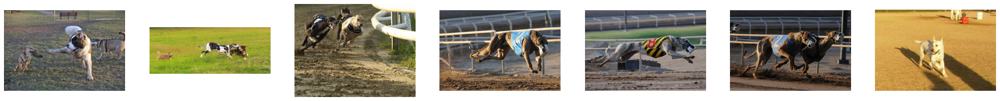

In [22]:
view_cluster1(3)

Clipping cluster size from 68 to 30


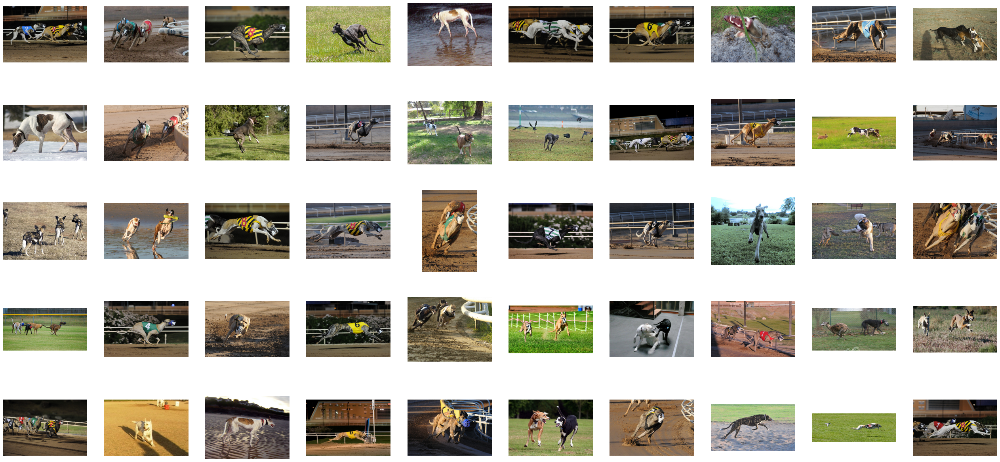

In [21]:
view_cluster(3)

In [18]:
def view_cluster(cluster):
    plt.figure(figsize = (45,45));
    # gets the list of filenames for a cluster
    files = groups[cluster]
    # only allow up to 30 images to be shown at a time
    if len(files) > 30:
        print(f"Clipping cluster size from {len(files)} to 30")
        files = files[:50]
    # plot each image in the cluster
    for index, file in enumerate(files):
        plt.subplot(10,10,index+1);
        img = load_img(file)
        img = np.array(img)
        plt.imshow(img)
        plt.axis('off')

Clipping cluster size from 82 to 30


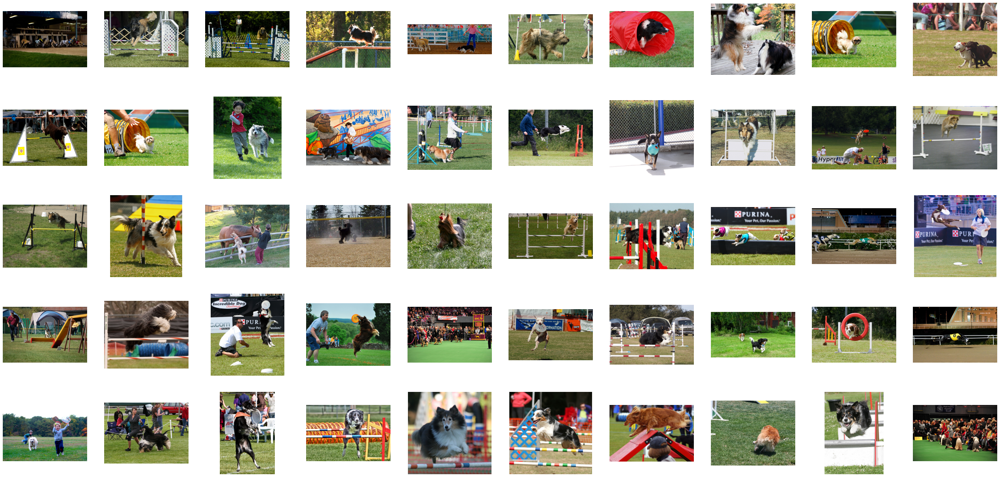

In [45]:
#stanford_cars (the variables is not saved. just for demo, so no need to run agian)
view_cluster(1)

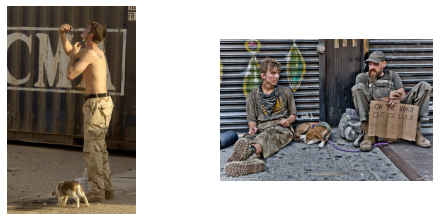

In [46]:
view_cluster(0)

Clipping cluster size from 89 to 30


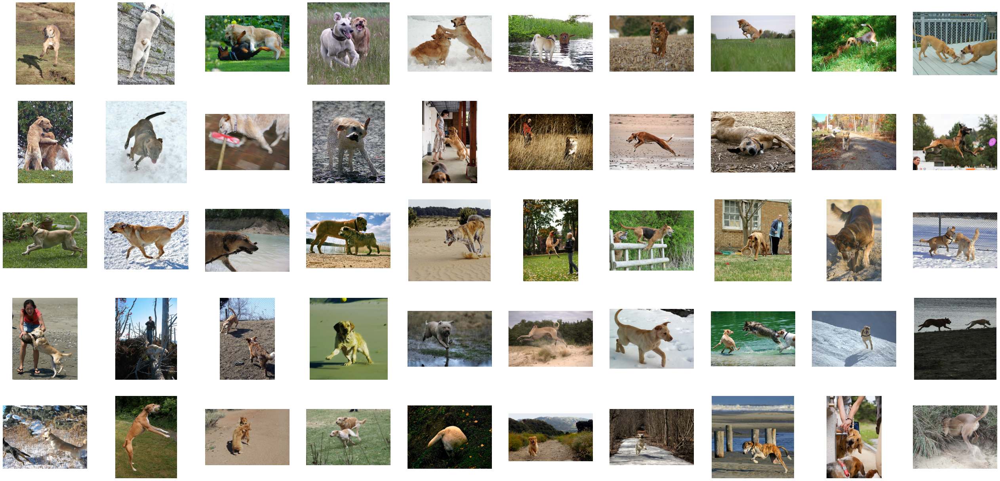

In [47]:
view_cluster(2)

Clipping cluster size from 68 to 30


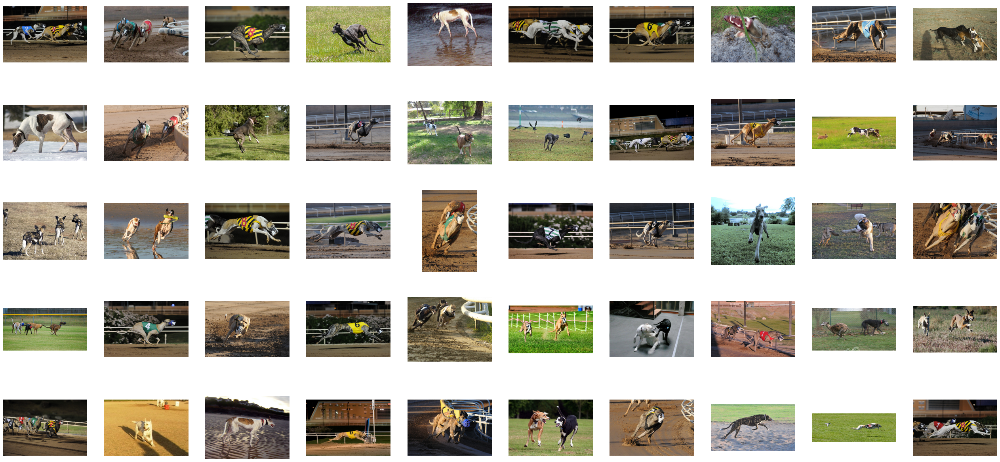

In [48]:
#Plane
view_cluster(3)

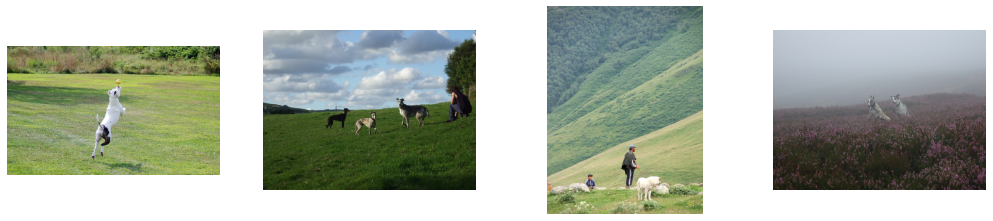

In [109]:
view_cluster(4)

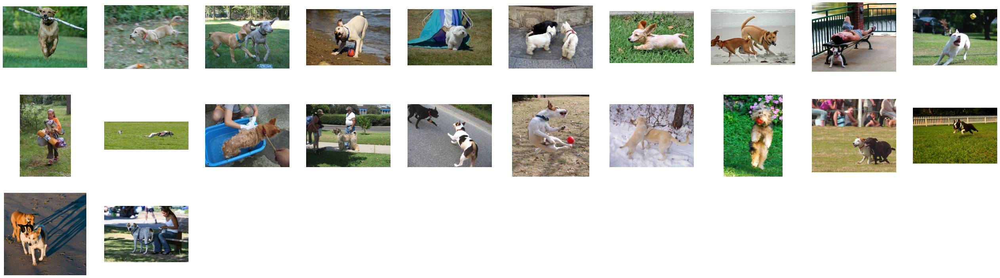

In [110]:
view_cluster(5)

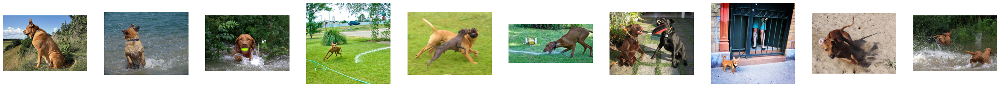

In [111]:
#dogs
view_cluster(6)

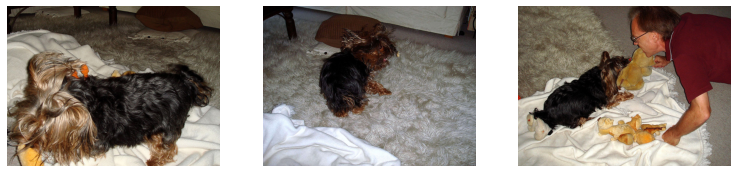

In [112]:
view_cluster(7)

Clipping cluster size from 157 to 30


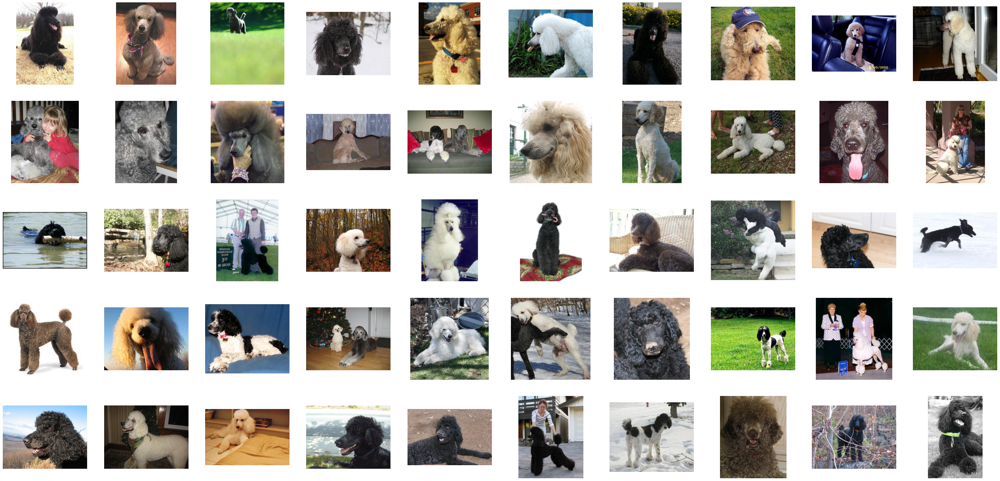

In [19]:
view_cluster(2)